In [1]:
import os
import glob
import pickle
import numpy as np
from tqdm import tqdm
import cv2
import matplotlib.pyplot as plt

In [2]:
def to_celsius(image):
        """Convert raw intensity values of radiometric image to Celsius scale."""
        return image*0.04-273.15

def preprocess_radiometric_frame(frame, equalize_hist=False):
    frame = to_celsius(frame)
    frame = (frame - np.min(frame)) / (np.max(frame) - np.min(frame))
    frame = (frame*255.0).astype(np.uint8)
    if equalize_hist:
        frame = cv2.equalizeHist(frame)
    return frame

def load_images(filepath, ir=True, max_num=None):
    images = []
    file_names = sorted(glob.glob(filepath))
    if max_num is not None:
        file_names = file_names[:max_num]
    for file_name in tqdm(file_names):
        if ir:
            image = cv2.imread(file_name, cv2.IMREAD_ANYDEPTH)
            image = preprocess_radiometric_frame(image)
            image = cv2.bitwise_not(image)
        else:
            image = cv2.imread(file_name, cv2.IMREAD_COLOR)
        images.append(image)
    print("Found {} images.".format(len(images)))
    return images, file_names

In [3]:
ir = False
images, file_names = load_images("images/rgb/*.jpg", ir, max_num=None)
#images = images[:100]

100%|██████████| 229/229 [09:36<00:00,  2.52s/it]

Found 229 images.


In [4]:
width, height = images[0].shape[1], images[0].shape[0]
print(width, height)

4000 3000


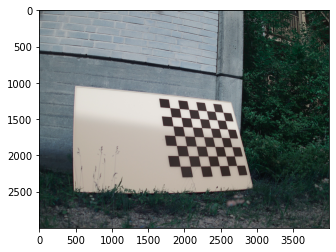

In [5]:
plt.imshow(images[0], cmap="gray")
plt.show()

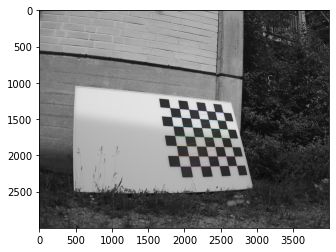

True


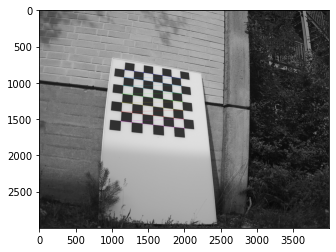

True


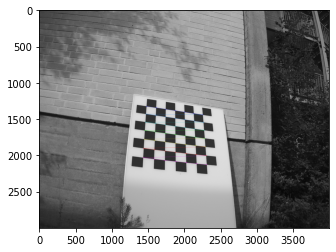

True


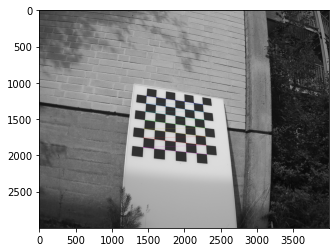

True


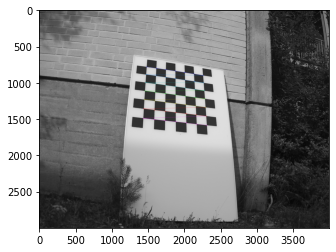

True


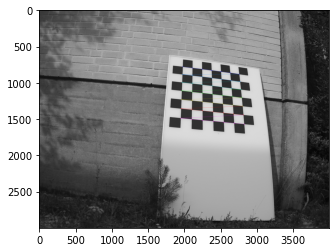

True


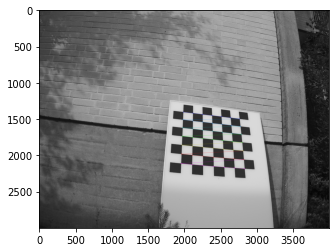

True


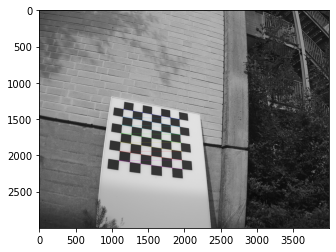

True


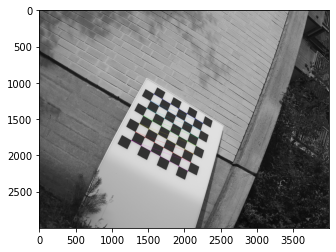

True


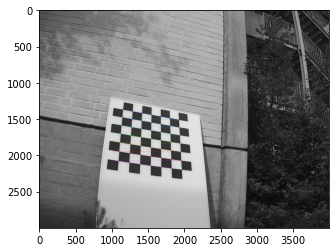

True


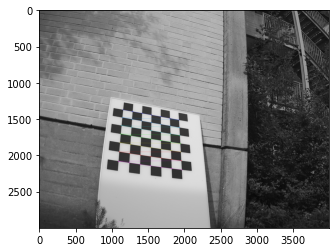

True


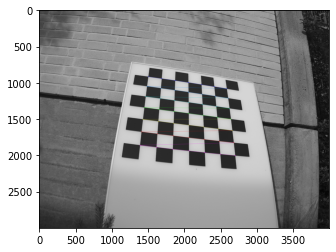

True


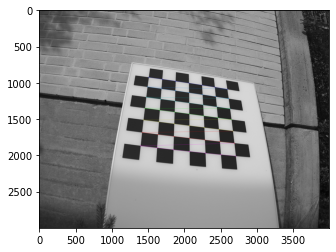

True


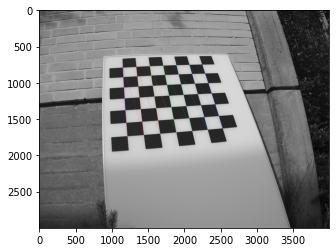

True


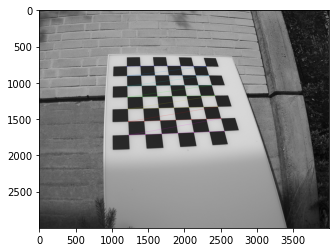

True


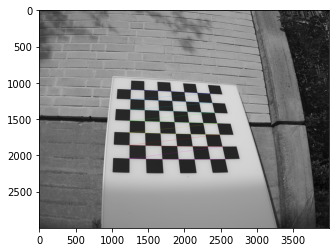

True


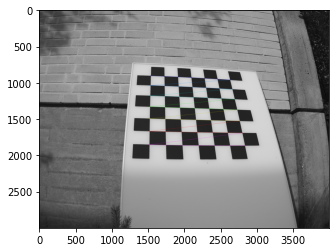

True


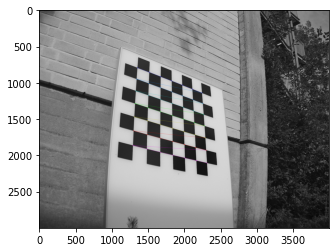

True


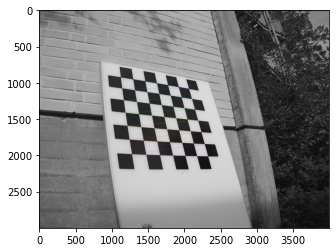

True


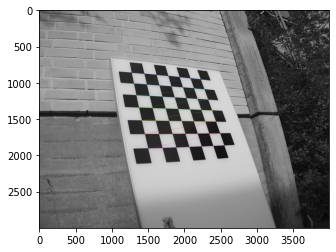

True


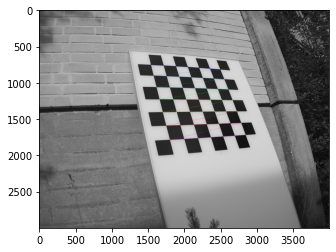

True


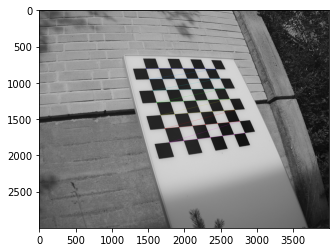

True


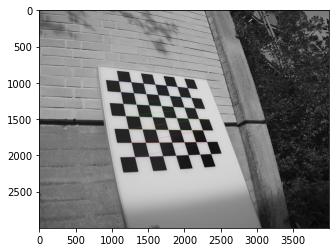

True


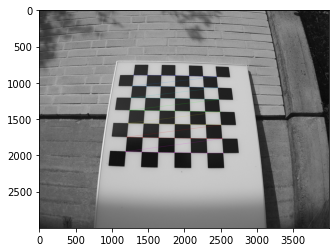

True


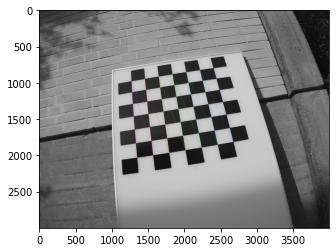

True


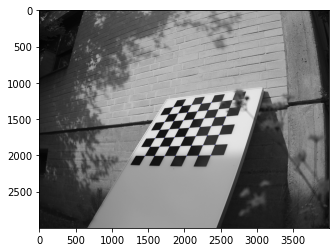

False


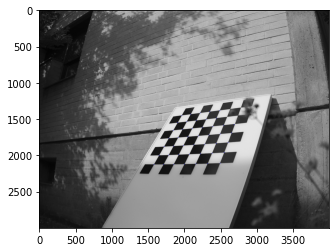

False


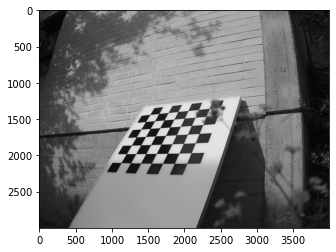

False


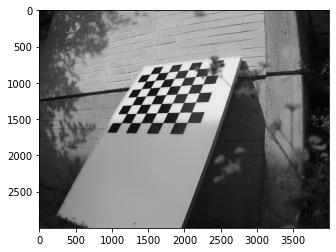

False


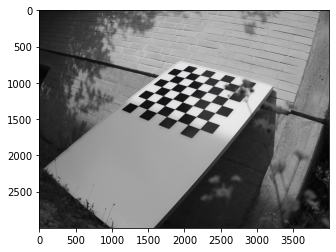

False


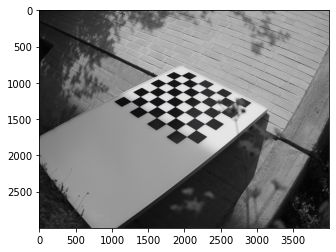

False


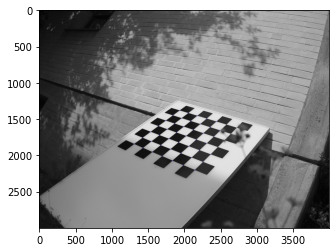

False


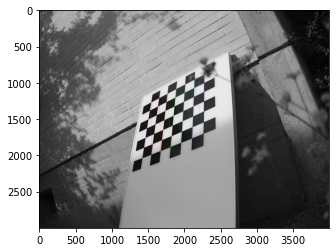

True


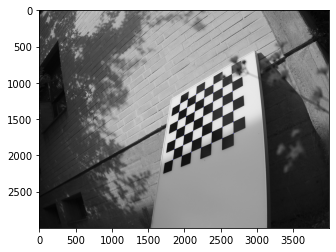

False


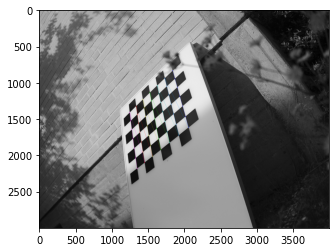

True


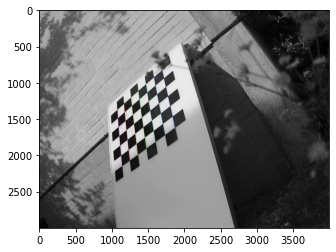

True


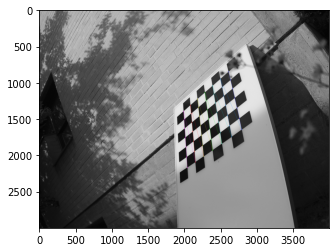

True


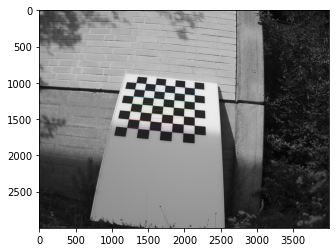

True


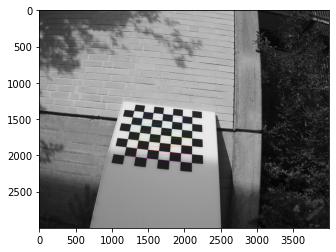

True


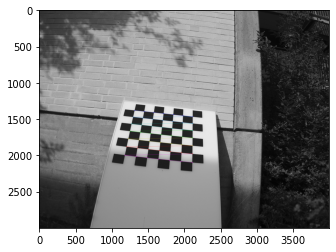

True


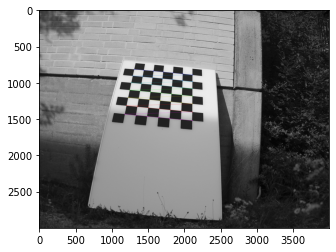

True


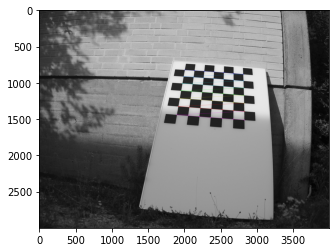

True


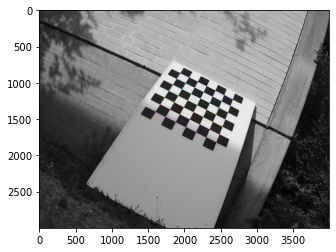

True


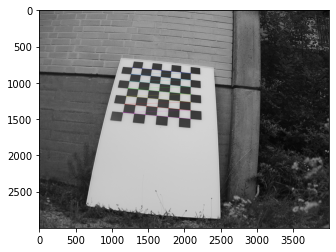

True


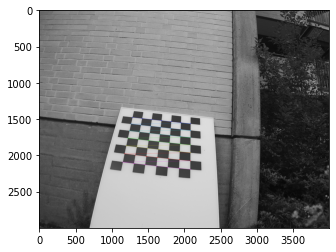

True


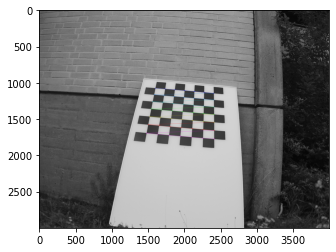

True


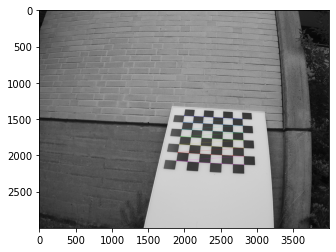

True


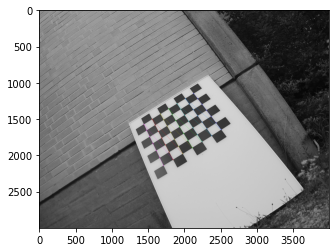

True


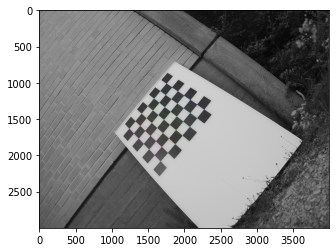

True


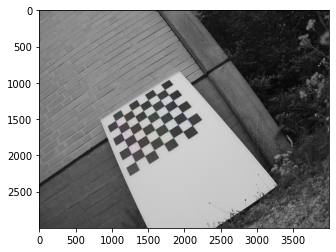

True


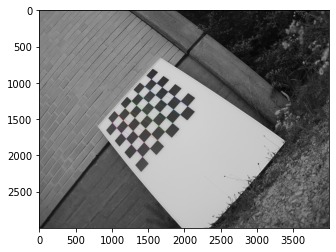

True


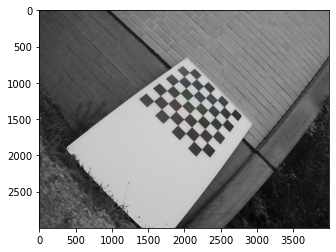

True


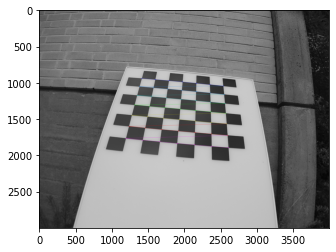

True


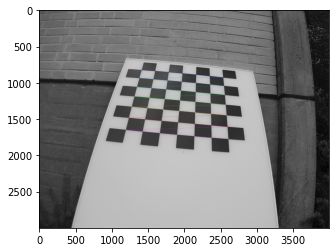

True


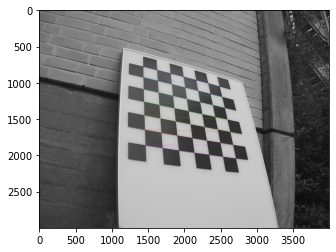

True


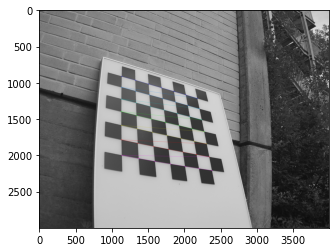

True


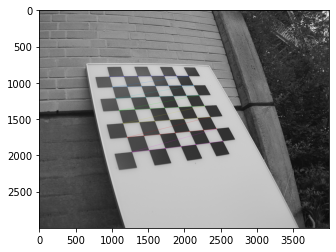

True


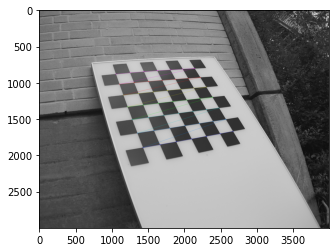

True


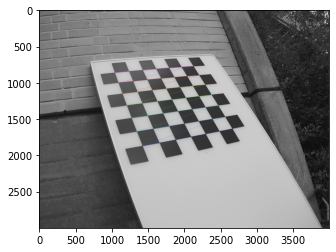

True


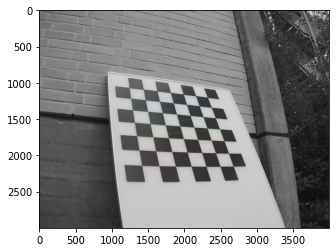

True


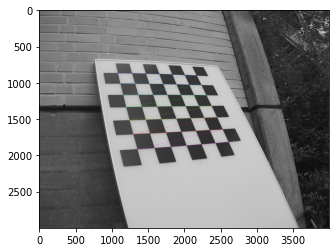

True


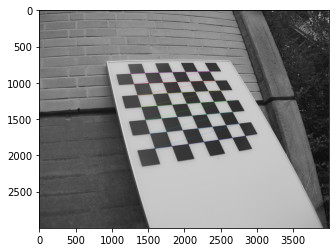

True


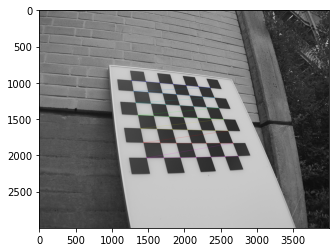

True


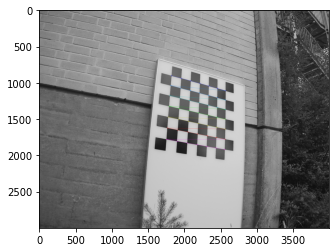

True


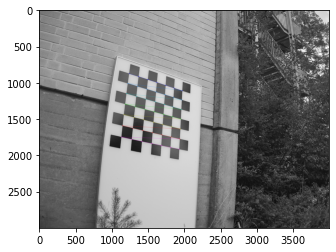

True


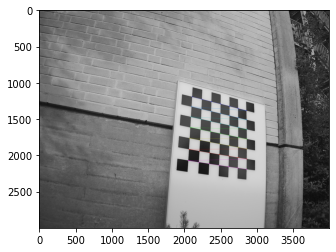

True


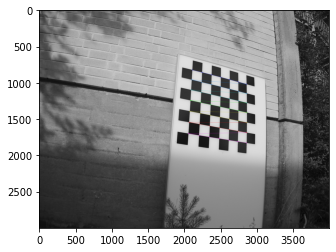

True


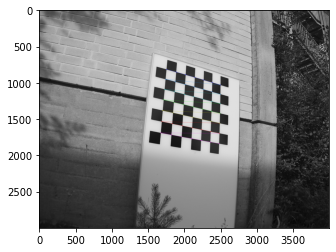

True


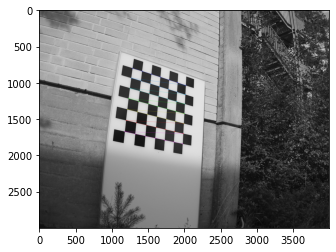

True


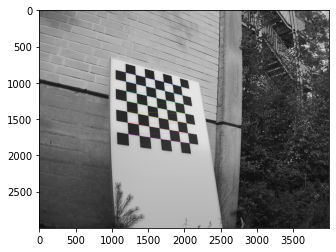

True


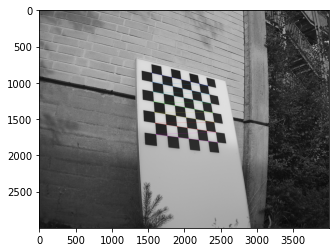

True


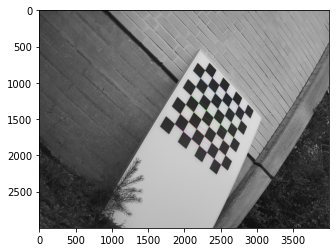

True


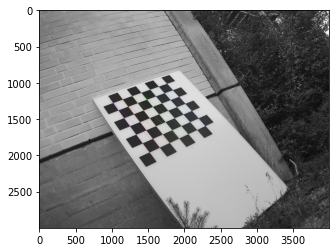

True


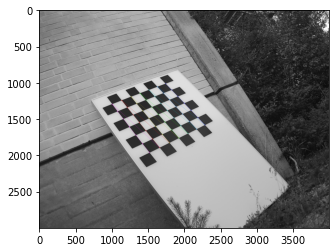

True


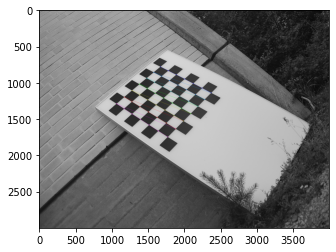

True


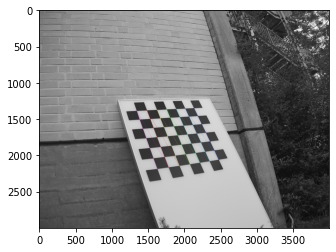

True


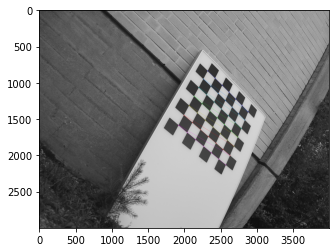

True


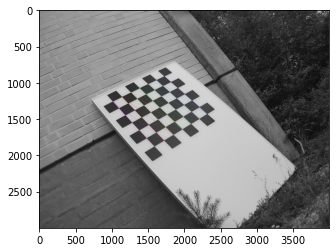

True


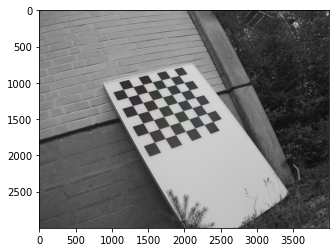

True


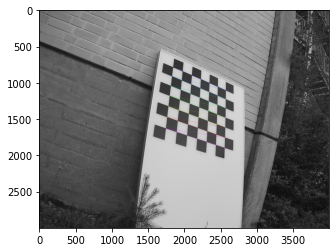

True


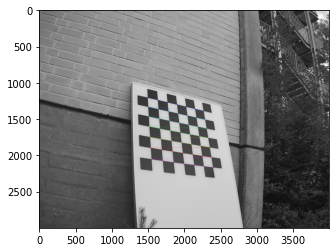

True


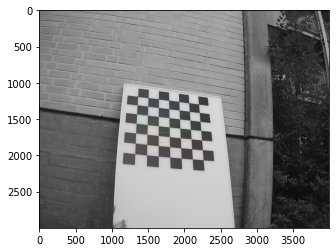

True


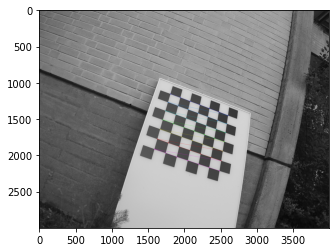

True


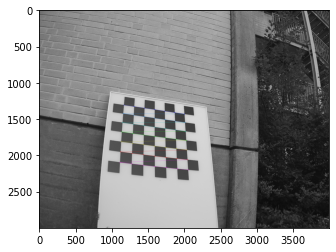

True


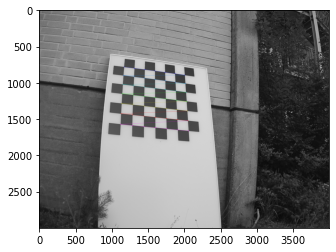

True


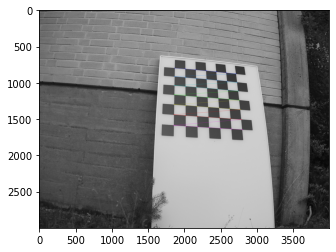

True


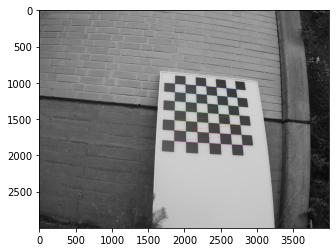

True


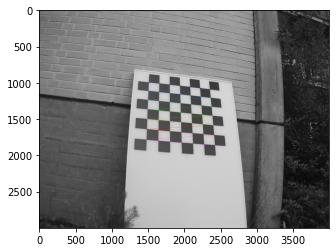

True


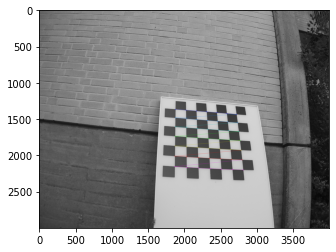

True


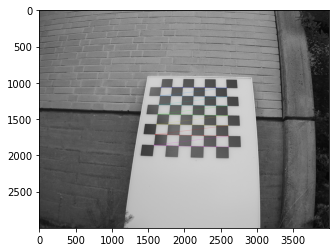

True


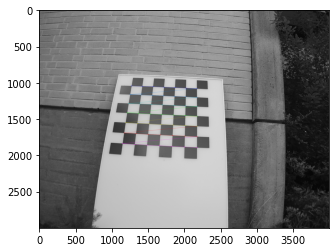

True


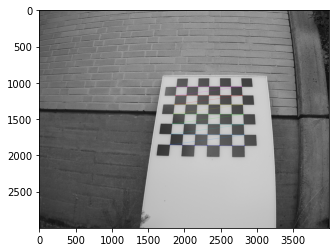

True


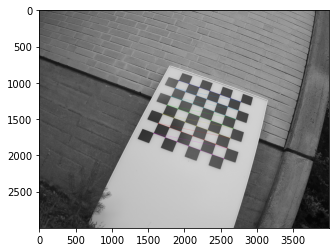

True


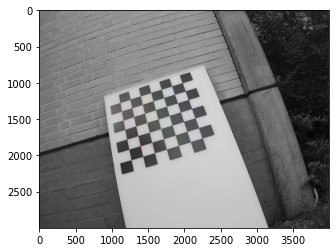

True


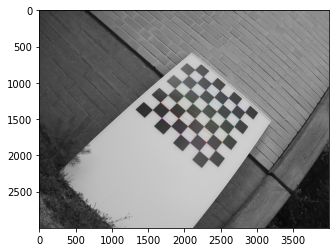

True


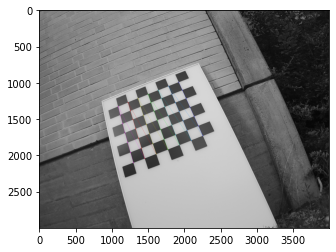

True


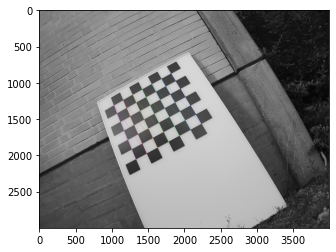

True


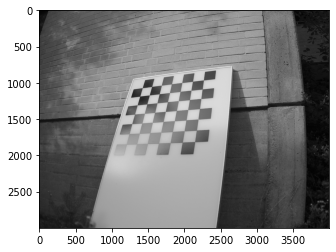

False


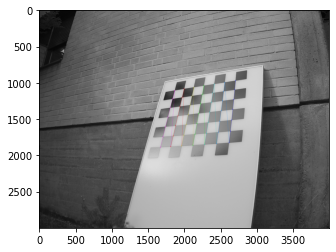

True


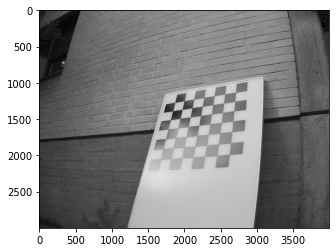

False


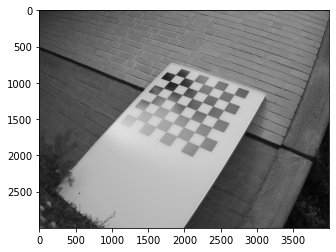

False


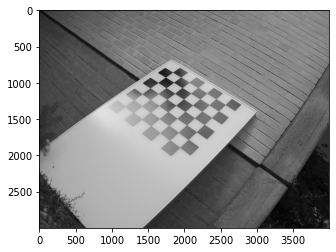

False


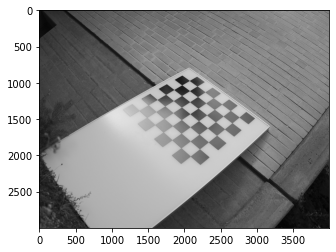

False


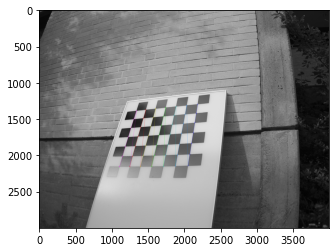

True


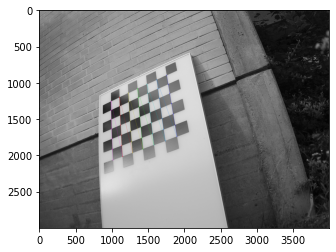

True


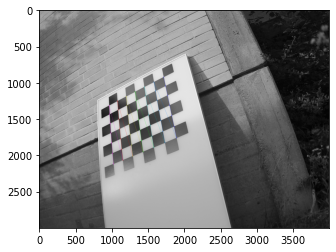

True


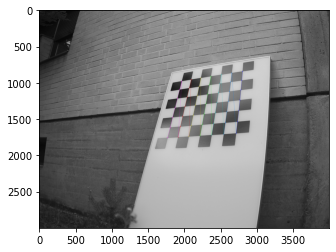

True


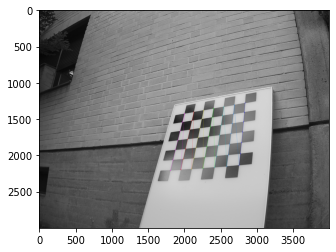

True


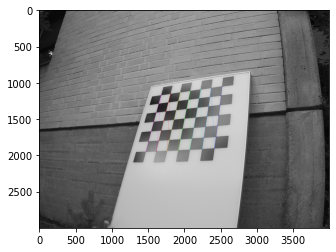

True


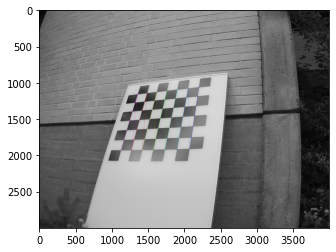

True


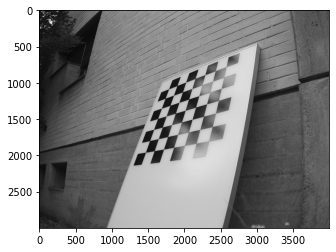

False


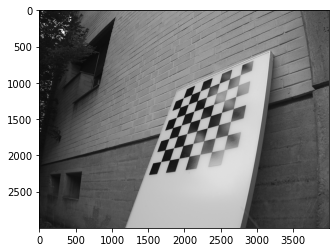

False


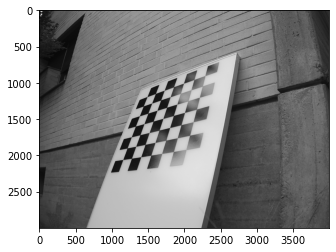

False


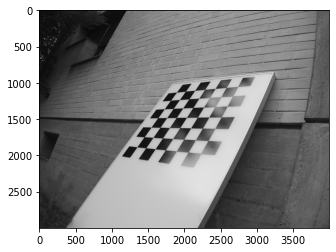

False


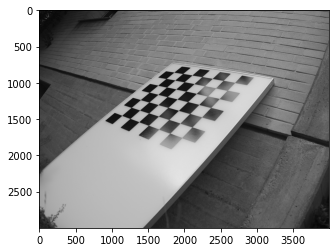

False


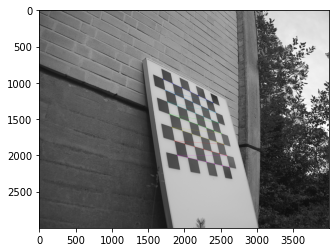

True


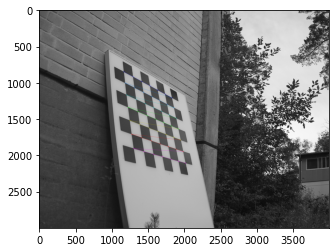

True


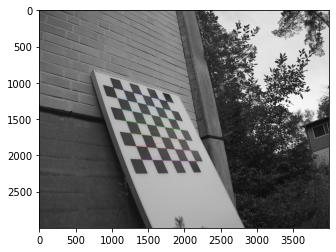

True


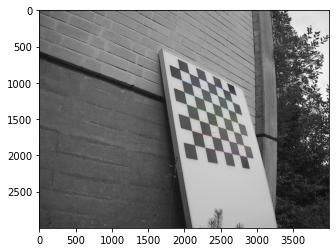

True


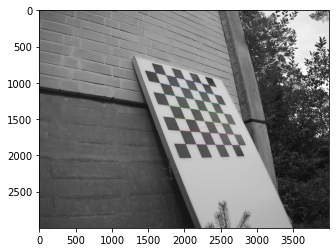

True


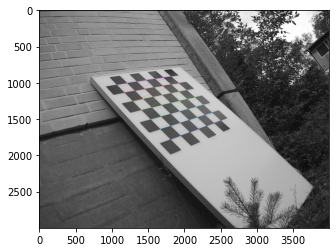

True


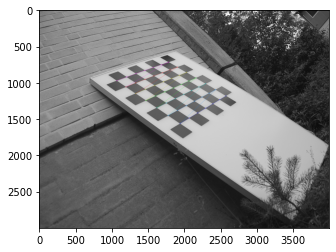

True


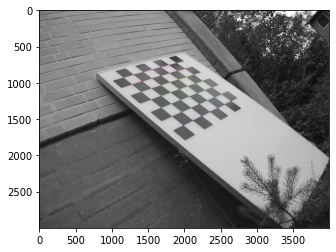

True


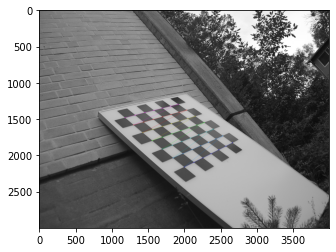

True


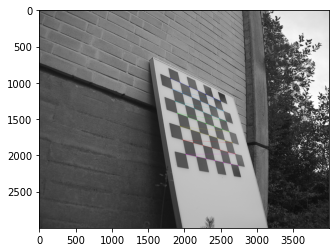

True


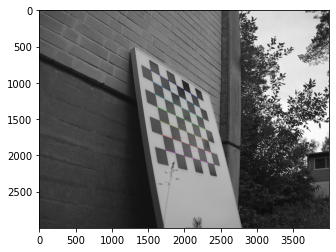

True


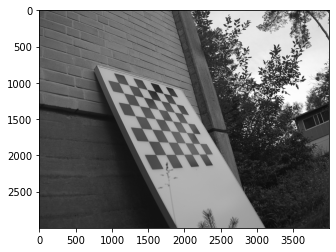

False


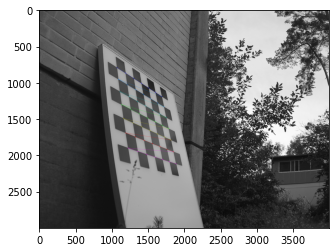

True


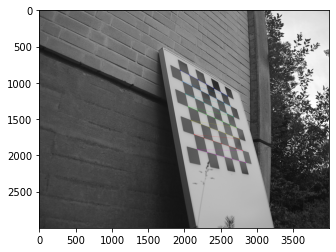

True


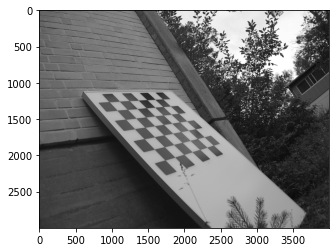

False


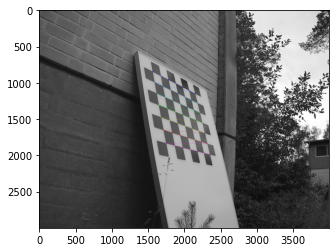

True


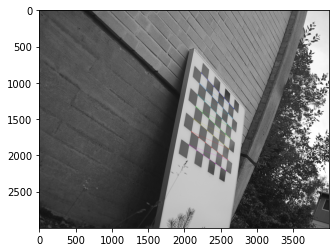

True


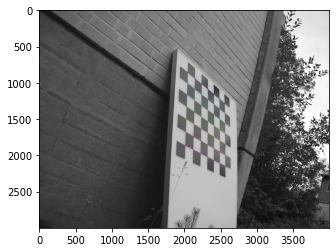

True


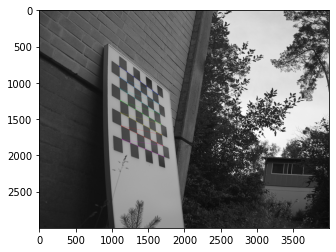

True


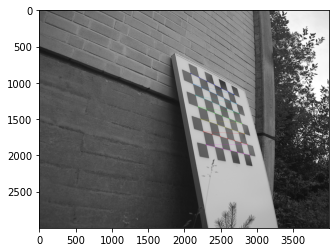

True


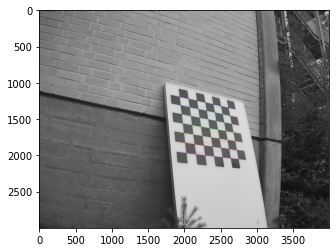

True


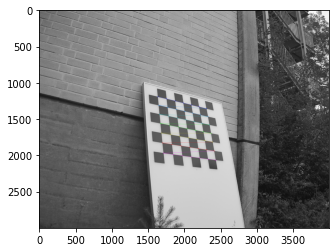

True


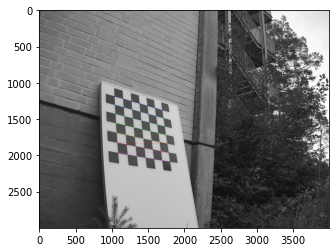

True


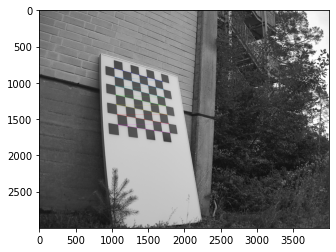

True


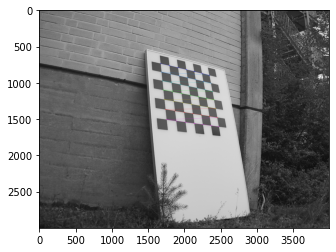

True


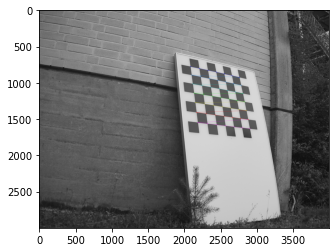

True


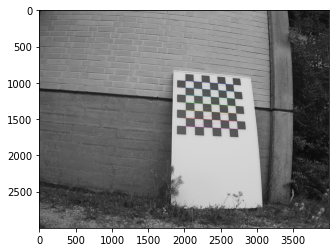

True


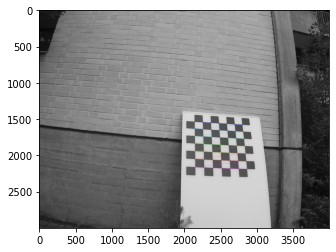

True


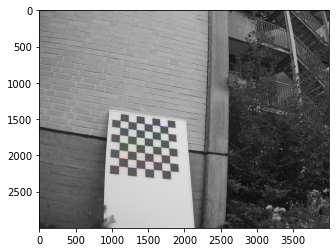

True


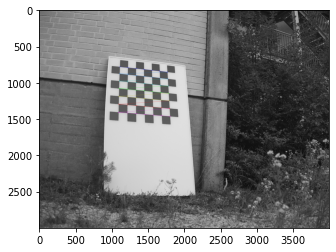

True


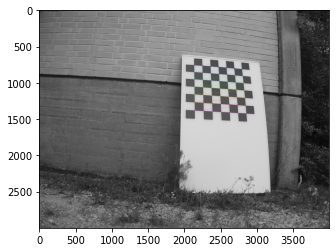

True


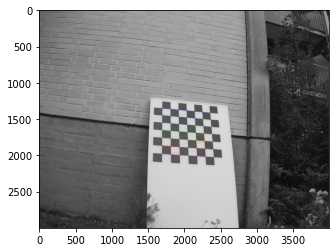

True


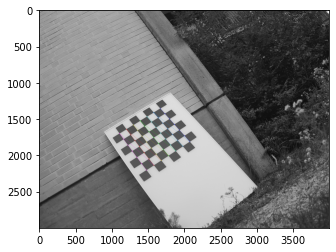

True


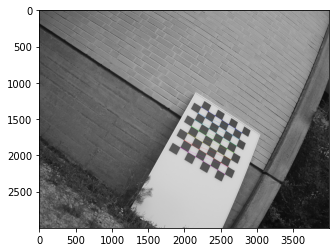

True


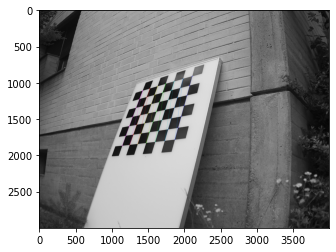

True


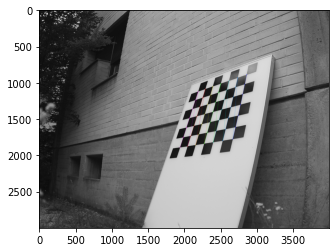

True


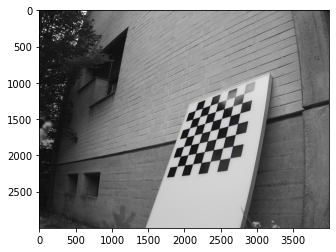

False


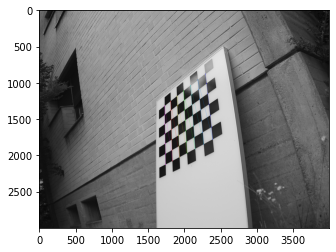

True


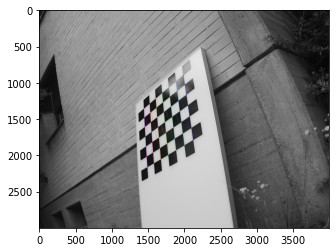

True


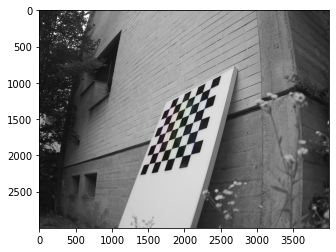

True


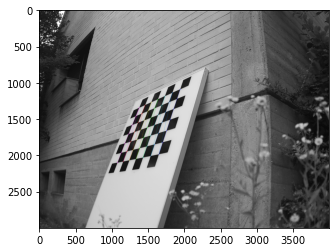

True


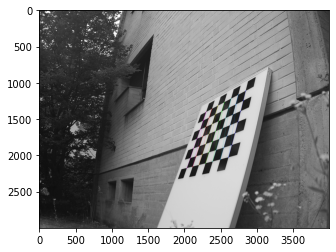

True


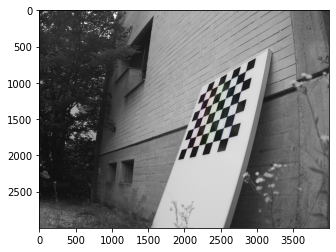

True


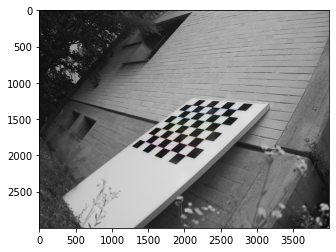

True


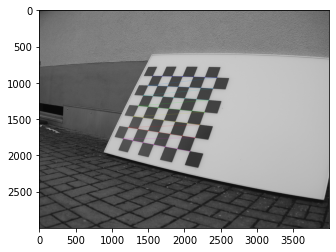

True


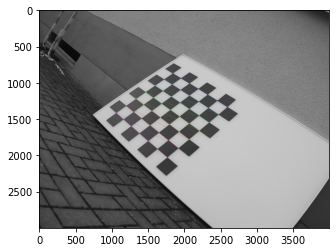

True


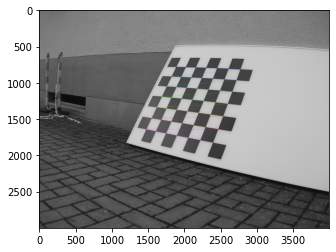

True


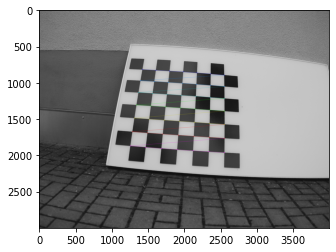

True


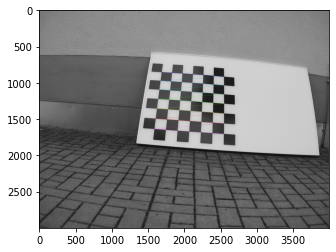

True


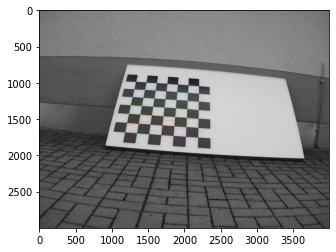

True


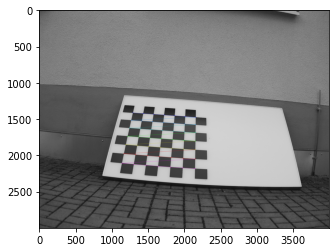

True


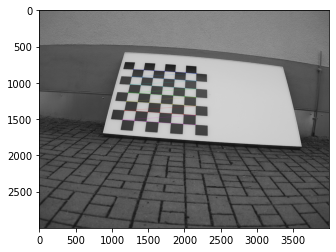

True


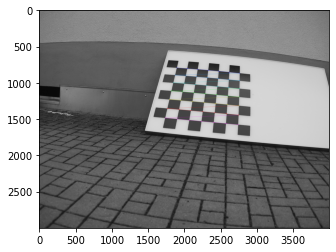

True


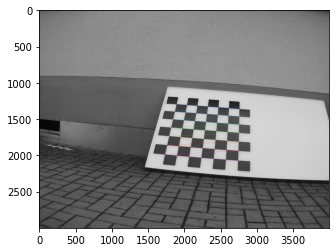

True


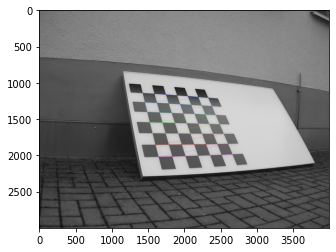

True


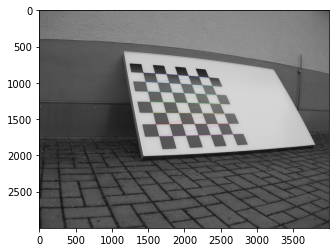

True


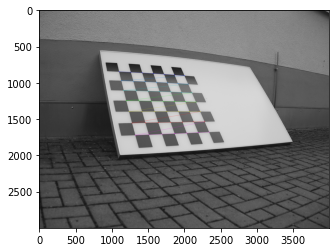

True


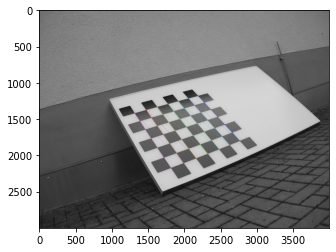

True


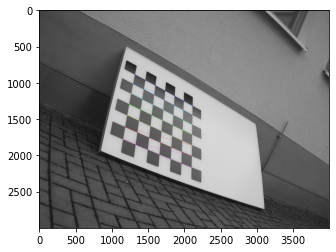

True


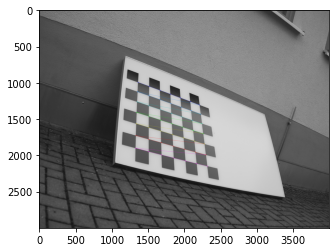

True


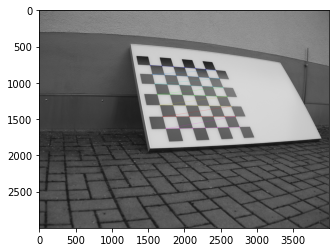

True


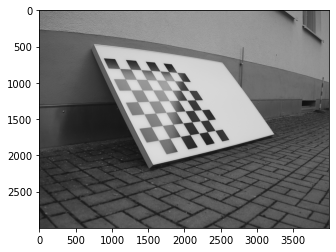

False


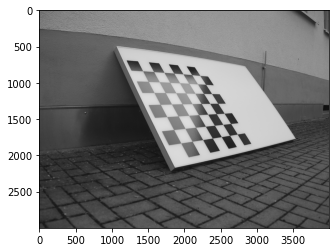

False


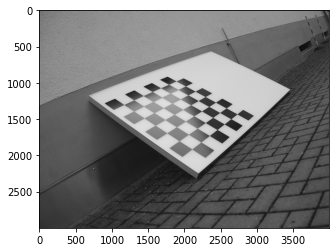

False


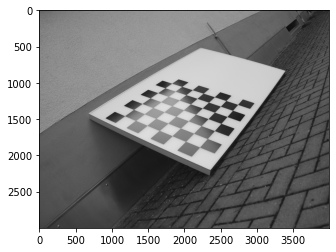

False


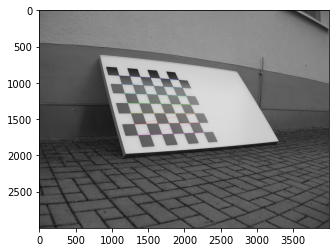

True


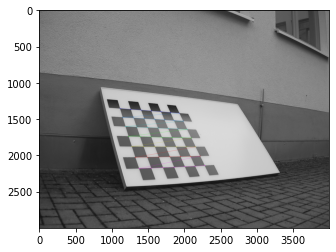

True


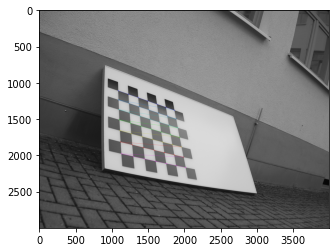

True


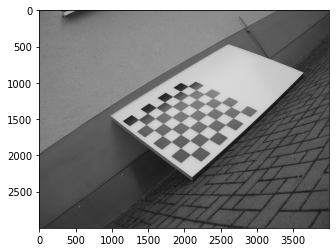

False


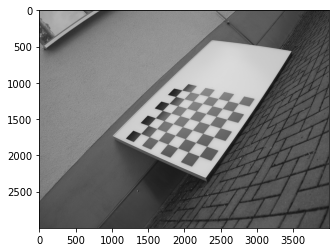

False


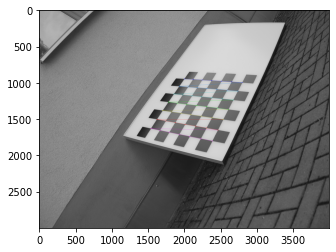

True


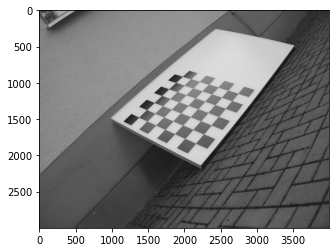

False


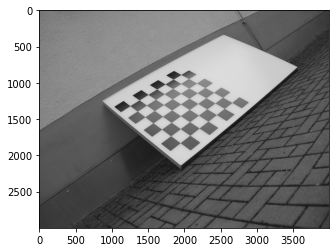

False


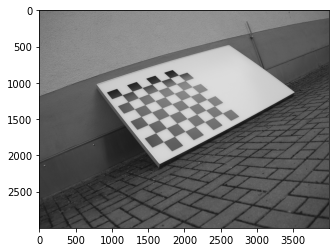

False


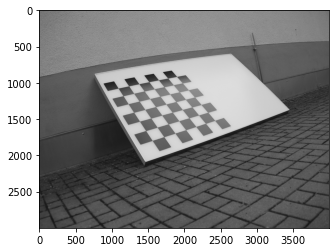

False


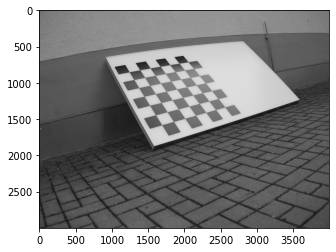

False


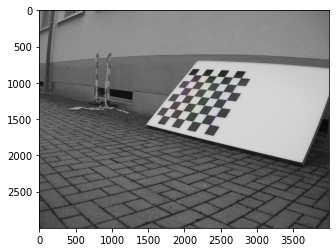

True


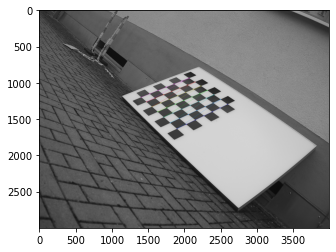

True


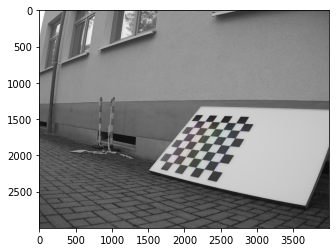

True


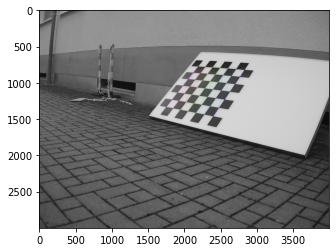

True


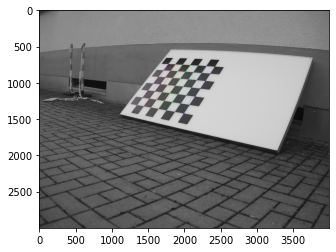

True


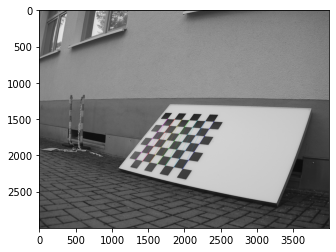

True


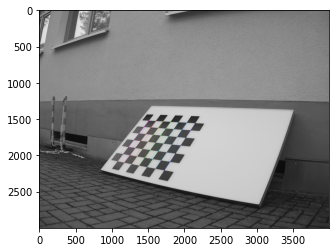

True


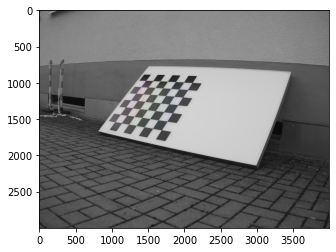

True


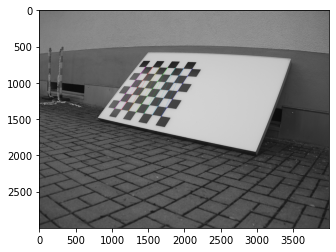

True


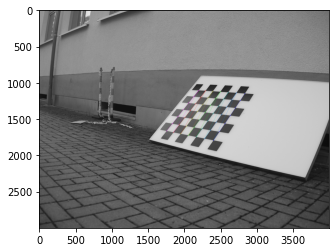

True


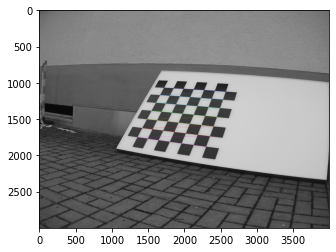

True


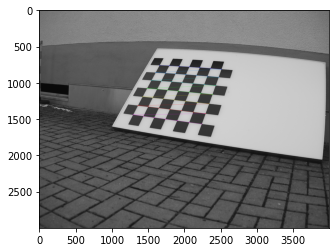

True


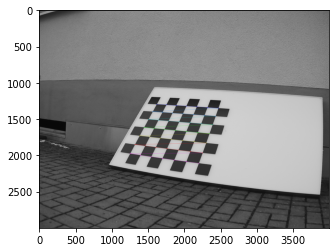

True


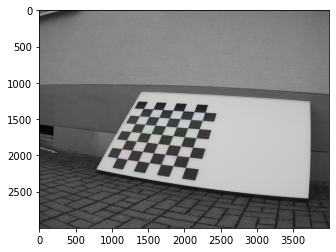

True


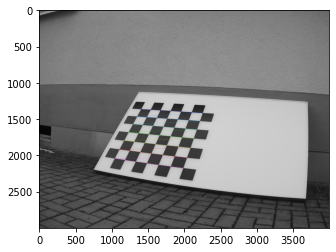

True


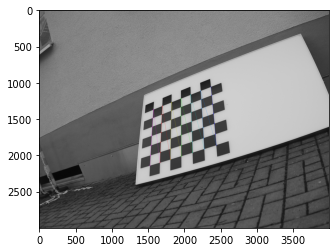

True


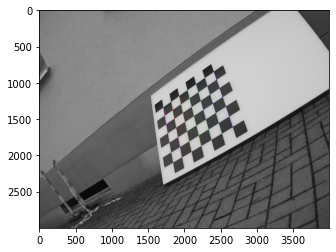

True


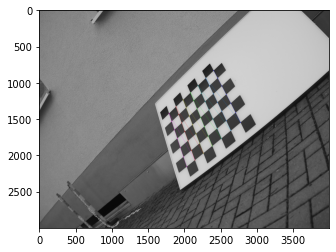

True


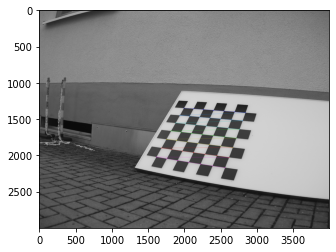

True


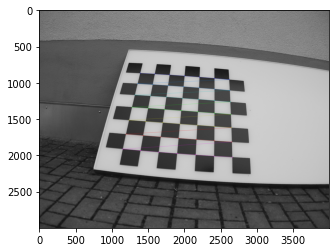

True


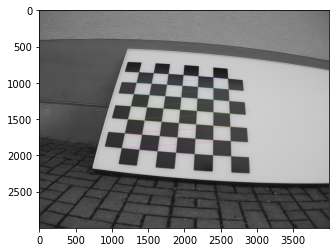

True


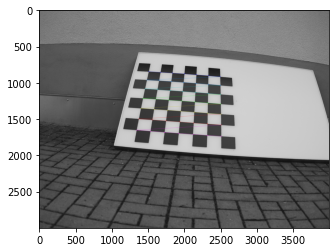

True


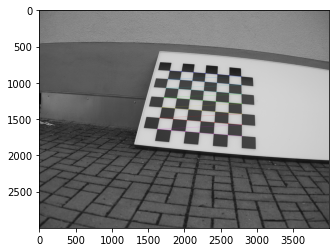

True


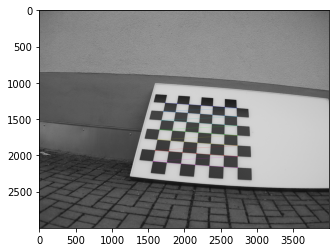

True


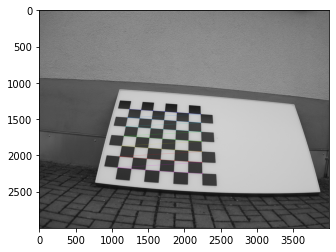

True


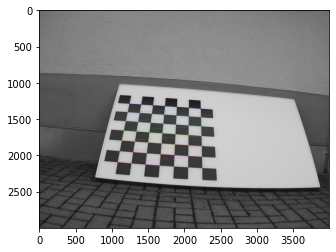

True


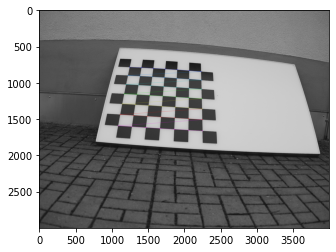

True


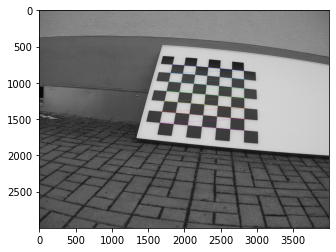

True


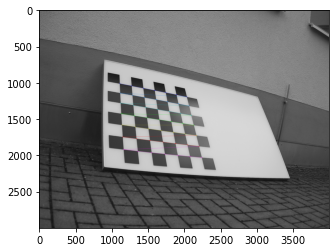

True


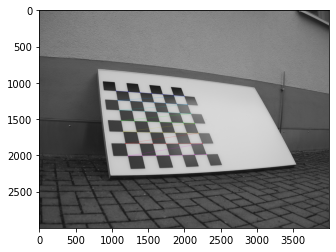

True


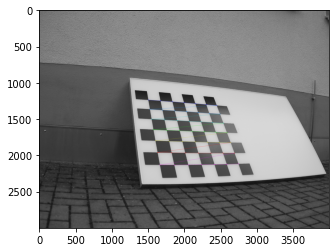

True


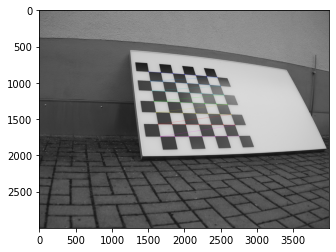

True


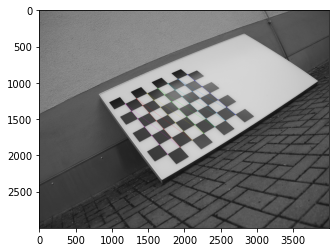

True


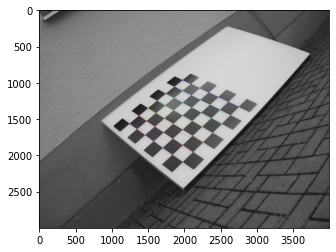

True


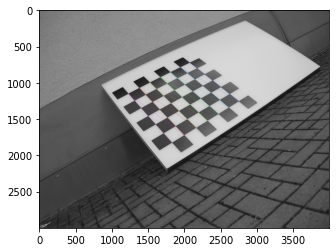

True


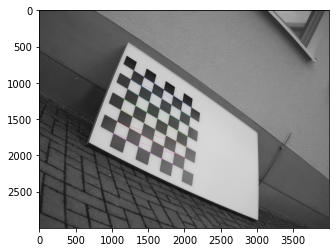

True


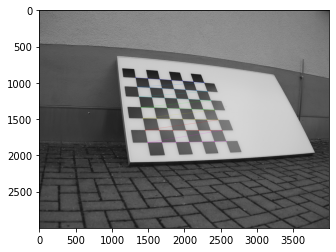

True


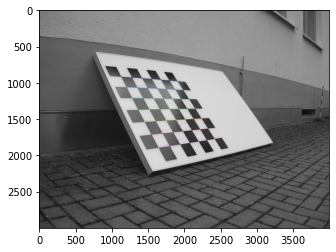

True


In [6]:
grid_size = (7,7)
rets = []
img_points = []
for image in images:
    if not ir:
        image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    ret, corners = cv2.findChessboardCorners(image, grid_size, None)
    if ret:
        criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)
        cv2.cornerSubPix(image, corners, (11, 11), (-1, -1), criteria)
        corners = corners.reshape(1, -1, 2)
        img_points.append(corners)
    
    image_rgb = cv2.cvtColor(image, cv2.COLOR_GRAY2BGR)
    cv2.drawChessboardCorners(image_rgb, grid_size, corners, ret)
    
    rets.append(ret)
    plt.imshow(image_rgb)
    plt.show()
    print(ret)

In [7]:
sum([r == True for r in rets])

197

In [8]:
def create_obj_points(num_images, grid_size):
    objp = np.zeros((grid_size[0]*grid_size[1], 3), np.float32)
    objp[:, :2] = np.mgrid[0:grid_size[0], 0:grid_size[1]].T.reshape(-1, 2)
    objp = objp.reshape(1, -1, 3)
    obj_points = []
    for i in range(num_images):
        obj_points.append(objp)
    return obj_points

obj_points = create_obj_points(len(img_points), grid_size=(7, 7))

In [9]:
def compute_intrinsic_parameters(obj_points, img_points, img_size):    
    error, camera_matrix, dist_coeffs, rvecs, tvecs = cv2.calibrateCamera(obj_points, img_points, img_size, None, None)
    print("Calibration of intrinsic camera parameters finished. The total reprojection error is {}.".format(error))
    return (camera_matrix, dist_coeffs, rvecs, tvecs)

In [10]:
camera_matrix, dist_coeffs, rvecs, tvecs = compute_intrinsic_parameters(obj_points, img_points, (width, height))

Calibration of intrinsic camera parameters finished. The total reprojection error is 0.7148649539414458.


In [11]:
camera_matrix  # all images

array([[4.06751868e+03, 0.00000000e+00, 1.95276553e+03],
       [0.00000000e+00, 4.07696828e+03, 1.52702723e+03],
       [0.00000000e+00, 0.00000000e+00, 1.00000000e+00]])

In [12]:
dist_coeffs

array([[-0.42833139,  0.31391599, -0.00087638, -0.00057701, -0.27893846]])

In [13]:
output_dir = "parameters/rgb"
os.makedirs(output_dir, exist_ok=True)
pickle.dump(camera_matrix, open(os.path.join(output_dir, "camera_matrix.pkl"), "wb"))
pickle.dump(dist_coeffs, open(os.path.join(output_dir, "dist_coeffs.pkl"), "wb"))
pickle.dump(rvecs, open(os.path.join(output_dir, "rvecs.pkl"), "wb"))
pickle.dump(tvecs, open(os.path.join(output_dir, "tvecs.pkl"), "wb"))

### Undistort images

In [14]:
new_camera_matrix, roi = cv2.getOptimalNewCameraMatrix(camera_matrix, dist_coeffs, (width, height), alpha=0.0)
new_camera_matrix, roi

(array([[3.62066089e+03, 0.00000000e+00, 1.93661558e+03],
        [0.00000000e+00, 3.83412915e+03, 1.52815663e+03],
        [0.00000000e+00, 0.00000000e+00, 1.00000000e+00]]),
 (0, 0, 3999, 2999))

In [15]:
mapx, mapy = cv2.initUndistortRectifyMap(camera_matrix, dist_coeffs, np.eye(3), new_camera_matrix, (width, height), cv2.CV_16SC2)

In [16]:
os.makedirs(os.path.join("out", "rgb", "original"), exist_ok=True)
os.makedirs(os.path.join("out", "rgb", "undistorted"), exist_ok=True)

for image, file_name in zip(images, file_names):    
    image_undistorted = cv2.remap(image, mapx, mapy, cv2.INTER_LINEAR)
    name = str.split(os.path.basename(file_name), ".")[0]
    cv2.imwrite(os.path.join("out", "rgb", "original", "{}.png".format(name)), image)
    cv2.imwrite(os.path.join("out", "rgb", "undistorted", "{}.png".format(name)), image_undistorted)